# Project 2 - Data Driven Prediction Models of Energy Use in Appliances

#### Problem Statement:
The objective of this project is to build a regression model for energy use by understanding the relationships between different variables and quantifying their impact

***Questions to be answered***

- Which variables are significant in predicting the energy consumption of appliances.
- How well those variables describe the appliances energy demands

***Goal:***
- Develop a model to find the variables which are significant for the appliances energy consumption with the available independent variables.

## Importing Libraries

In [2]:
#imporitng the required packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
import warnings
warnings.filterwarnings('ignore')

## Loading the Dataset 

In [3]:
#Read the csv file using pandas
appliances_df = pd.read_csv('energydata_complete.csv')

In [4]:
#columns of data
appliances_df.columns

Index(['date', 'Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint', 'rv1', 'rv2'],
      dtype='object')

In [5]:
#Inspect first few rows
appliances_df.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


## Data Cleaning

In [6]:
# number of seconds from midnight,day of week and week status are presented in 
# the data variables description so we are adding those in the data frame.
# we are going to add also information about the month as it may be useful
appliances_df['month'] = pd.DatetimeIndex(appliances_df['date']).month
datetime=pd.to_datetime(appliances_df['date'])
nsm = (datetime - datetime.dt.normalize()).dt.total_seconds()
appliances_df['NSM']=nsm
appliances_df['day_of_week'] = pd.DatetimeIndex(appliances_df['date']).day_name()
week_stat = pd.to_datetime(appliances_df['date'])
appliances_df['week_status'] = list(map(int, week_stat.dt.weekday >= 5))
appliances_df

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,month,NSM,day_of_week,week_status
0,2016-01-11 17:00:00,60,30,19.890000,47.596667,19.200000,44.790000,19.790000,44.730000,19.000000,...,92.000000,7.000000,63.000000,5.300000,13.275433,13.275433,1,61200.0,Monday,0
1,2016-01-11 17:10:00,60,30,19.890000,46.693333,19.200000,44.722500,19.790000,44.790000,19.000000,...,92.000000,6.666667,59.166667,5.200000,18.606195,18.606195,1,61800.0,Monday,0
2,2016-01-11 17:20:00,50,30,19.890000,46.300000,19.200000,44.626667,19.790000,44.933333,18.926667,...,92.000000,6.333333,55.333333,5.100000,28.642668,28.642668,1,62400.0,Monday,0
3,2016-01-11 17:30:00,50,40,19.890000,46.066667,19.200000,44.590000,19.790000,45.000000,18.890000,...,92.000000,6.000000,51.500000,5.000000,45.410389,45.410389,1,63000.0,Monday,0
4,2016-01-11 17:40:00,60,40,19.890000,46.333333,19.200000,44.530000,19.790000,45.000000,18.890000,...,92.000000,5.666667,47.666667,4.900000,10.084097,10.084097,1,63600.0,Monday,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19730,2016-05-27 17:20:00,100,0,25.566667,46.560000,25.890000,42.025714,27.200000,41.163333,24.700000,...,55.666667,3.333333,23.666667,13.333333,43.096812,43.096812,5,62400.0,Friday,0
19731,2016-05-27 17:30:00,90,0,25.500000,46.500000,25.754000,42.080000,27.133333,41.223333,24.700000,...,56.000000,3.500000,24.500000,13.300000,49.282940,49.282940,5,63000.0,Friday,0
19732,2016-05-27 17:40:00,270,10,25.500000,46.596667,25.628571,42.768571,27.050000,41.690000,24.700000,...,56.333333,3.666667,25.333333,13.266667,29.199117,29.199117,5,63600.0,Friday,0
19733,2016-05-27 17:50:00,420,10,25.500000,46.990000,25.414000,43.036000,26.890000,41.290000,24.700000,...,56.666667,3.833333,26.166667,13.233333,6.322784,6.322784,5,64200.0,Friday,0


In [7]:
# the new columns provide enough information about time 
# making it possible to drop the date column 
appliances_df.drop(['date'], axis = 1, inplace = True)

## EDA

In [8]:
appliances_df.columns

Index(['Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4',
       'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9',
       'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility',
       'Tdewpoint', 'rv1', 'rv2', 'month', 'NSM', 'day_of_week',
       'week_status'],
      dtype='object')

In [9]:
#Inspect data frame after dropping
appliances_df.head()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,month,NSM,day_of_week,week_status
0,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,...,92.0,7.000000,63.000000,5.3,13.275433,13.275433,1,61200.0,Monday,0
1,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,...,92.0,6.666667,59.166667,5.2,18.606195,18.606195,1,61800.0,Monday,0
2,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,...,92.0,6.333333,55.333333,5.1,28.642668,28.642668,1,62400.0,Monday,0
3,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,...,92.0,6.000000,51.500000,5.0,45.410389,45.410389,1,63000.0,Monday,0
4,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,...,92.0,5.666667,47.666667,4.9,10.084097,10.084097,1,63600.0,Monday,0


In [10]:
appliances_df.shape

(19735, 32)

In [11]:
appliances_df.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,month,NSM,week_status
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,...,755.522602,79.750418,4.039752,38.330834,3.760707,24.988033,24.988033,3.101647,42907.129465,0.277274
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,...,7.399441,14.901088,2.451221,11.794719,4.194648,14.496634,14.496634,1.339200,24940.020831,0.447664
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,...,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322,1.000000,0.000000,0.000000
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,...,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889,2.000000,21600.000000,0.000000
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,...,756.100000,83.666667,3.666667,40.000000,3.433333,24.897653,24.897653,3.000000,43200.000000,0.000000
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,...,760.933333,91.666667,5.500000,40.000000,6.566667,37.583769,37.583769,4.000000,64200.000000,1.000000
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,...,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530,5.000000,85800.000000,1.000000


In [12]:
appliances_df.month.value_counts()

3    4464
4    4320
2    4176
5    3853
1    2922
Name: month, dtype: int64

In [13]:
appliances_df.Visibility.value_counts()

40.000000    7224
29.000000     449
36.333333     257
23.000000     247
28.000000     245
             ... 
33.277778       1
35.722222       1
61.916667       1
2.500000        1
32.361111       1
Name: Visibility, Length: 413, dtype: int64

In [14]:
appliances_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 32 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Appliances   19735 non-null  int64  
 1   lights       19735 non-null  int64  
 2   T1           19735 non-null  float64
 3   RH_1         19735 non-null  float64
 4   T2           19735 non-null  float64
 5   RH_2         19735 non-null  float64
 6   T3           19735 non-null  float64
 7   RH_3         19735 non-null  float64
 8   T4           19735 non-null  float64
 9   RH_4         19735 non-null  float64
 10  T5           19735 non-null  float64
 11  RH_5         19735 non-null  float64
 12  T6           19735 non-null  float64
 13  RH_6         19735 non-null  float64
 14  T7           19735 non-null  float64
 15  RH_7         19735 non-null  float64
 16  T8           19735 non-null  float64
 17  RH_8         19735 non-null  float64
 18  T9           19735 non-null  float64
 19  RH_9

### Missing values

#### As we have already seen there are no missing values. However, let us verify it again

In [15]:
#Print null counts by column
appliances_df.isnull().sum()

Appliances     0
lights         0
T1             0
RH_1           0
T2             0
RH_2           0
T3             0
RH_3           0
T4             0
RH_4           0
T5             0
RH_5           0
T6             0
RH_6           0
T7             0
RH_7           0
T8             0
RH_8           0
T9             0
RH_9           0
T_out          0
Press_mm_hg    0
RH_out         0
Windspeed      0
Visibility     0
Tdewpoint      0
rv1            0
rv2            0
month          0
NSM            0
day_of_week    0
week_status    0
dtype: int64

#### There are 19735 rows and 32 columns in the data set. There are no null values in any of the columns.

In [16]:
appliances_df.corr()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,month,NSM,week_status
Appliances,1.000000,0.197278,0.055447,0.086031,0.120073,-0.060465,0.085060,0.036292,0.040281,0.016965,...,-0.034885,-0.152282,0.087122,0.000230,0.015353,-0.011145,-0.011145,-0.011606,0.217152,0.017437
lights,0.197278,1.000000,-0.023528,0.106968,-0.005622,0.050985,-0.097393,0.131161,-0.008859,0.114936,...,-0.010576,0.068543,0.060281,0.020038,-0.036322,0.000521,0.000521,-0.179452,0.254993,-0.051404
T1,0.055447,-0.023528,1.000000,0.164006,0.836834,-0.002509,0.892402,-0.028550,0.877001,0.097861,...,-0.150574,-0.345481,-0.087654,-0.076210,0.571309,-0.006203,-0.006203,0.706305,0.178728,0.010885
RH_1,0.086031,0.106968,0.164006,1.000000,0.269839,0.797535,0.253230,0.844677,0.106180,0.880359,...,-0.293957,0.274126,0.204932,-0.021057,0.639106,-0.000699,-0.000699,-0.094048,0.018531,-0.018641
T2,0.120073,-0.005622,0.836834,0.269839,1.000000,-0.165610,0.735245,0.121497,0.762066,0.231563,...,-0.133028,-0.505291,0.052495,-0.069721,0.582602,-0.011087,-0.011087,0.533479,0.254569,-0.005065
RH_2,-0.060465,0.050985,-0.002509,0.797535,-0.165610,1.000000,0.137319,0.678326,-0.047304,0.721435,...,-0.255646,0.584911,0.069190,-0.005368,0.499152,0.006275,0.006275,-0.097914,-0.183182,-0.001965
T3,0.085060,-0.097393,0.892402,0.253230,0.735245,0.137319,1.000000,-0.011234,0.852778,0.122737,...,-0.189974,-0.281718,-0.100776,-0.102310,0.645886,-0.005194,-0.005194,0.790365,0.037607,-0.009326
RH_3,0.036292,0.131161,-0.028550,0.844677,0.121497,0.678326,-0.011234,1.000000,-0.140457,0.898978,...,-0.233274,0.356192,0.263188,0.017041,0.414387,-0.000477,-0.000477,-0.414359,-0.052343,-0.013382
T4,0.040281,-0.008859,0.877001,0.106180,0.762066,-0.047304,0.852778,-0.140457,1.000000,-0.048650,...,-0.075292,-0.388602,-0.185747,-0.104768,0.519471,-0.001815,-0.001815,0.789168,0.088334,-0.093141
RH_4,0.016965,0.114936,0.097861,0.880359,0.231563,0.721435,0.122737,0.898978,-0.048650,1.000000,...,-0.250748,0.336813,0.300192,0.002636,0.616509,-0.001787,-0.001787,-0.258167,-0.019040,0.031205


###  Outliers

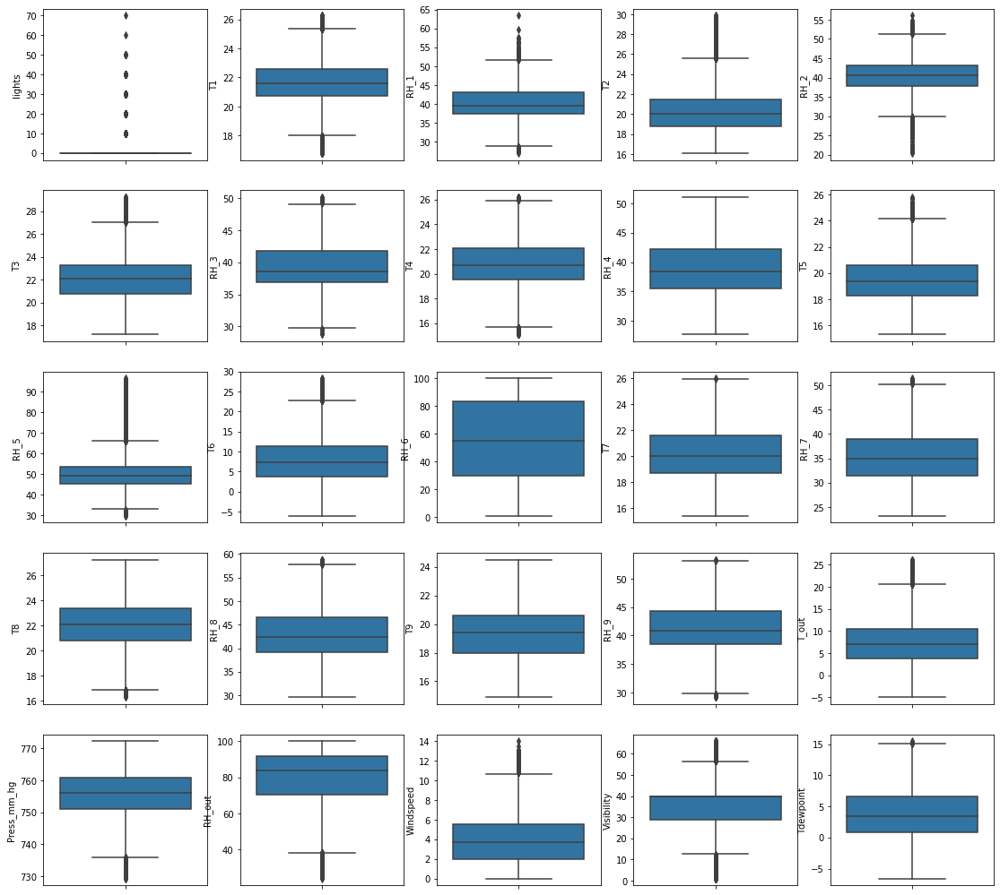

In [17]:
# Draw box plots for indepent variables with continuous values
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint',]
plt.figure(figsize=(19,18))

i = 1
for col in cols:
    plt.subplot(5,5,i)
    sns.boxplot(y=col, data=appliances_df)
    i+=1

#### From these plots, we can see some outliers, but their impact could be minor .

#### Pair Plots to check the linear relationship
#### might take a while for the plots to appear 

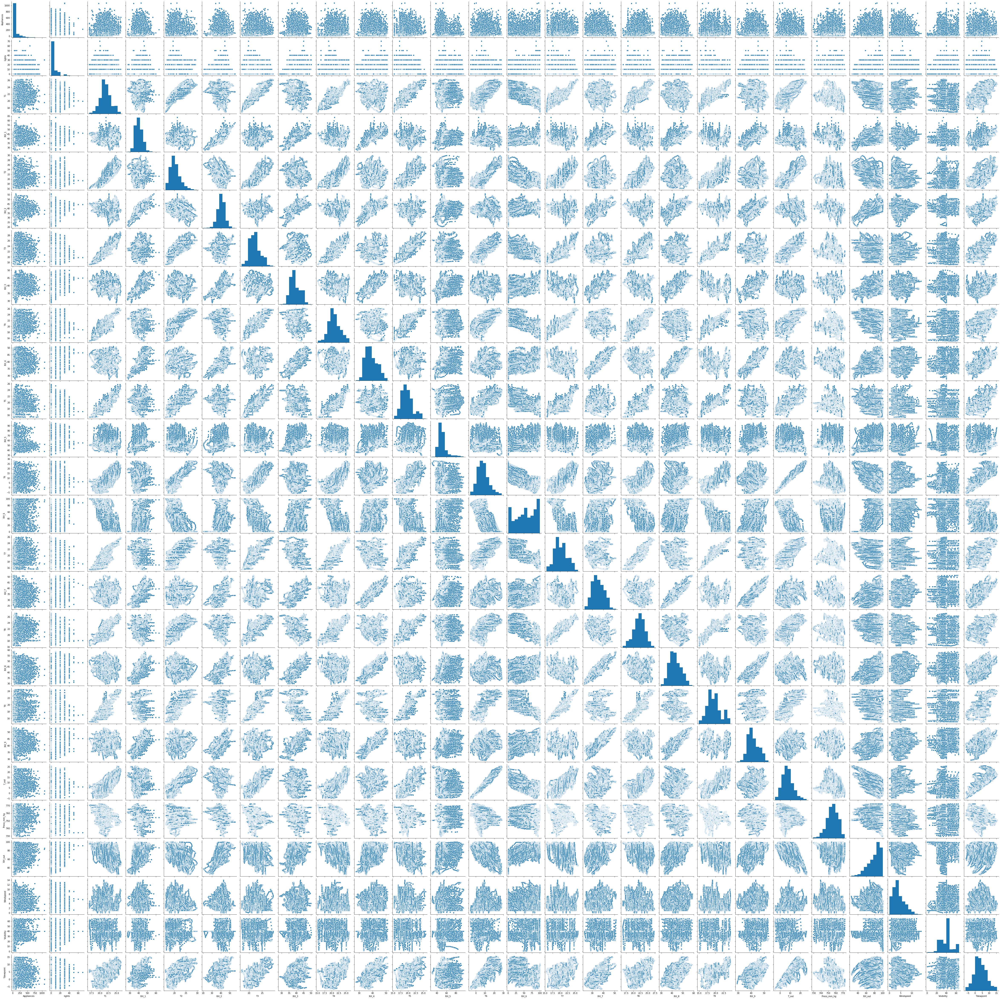

In [18]:
#Draw pairplots for continuous numeric variables using seaborn
#plt.figure(figsize = (15,30))
sns.pairplot(data=appliances_df,vars=['Appliances','lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint',])
#plt.show()

#### _`Inference`_: 
- the target variable (appliances) doesnt seem to especially correlate with any other variable 
- the temperature variables are the most correlated althought results may vary 

#### Visualising the Data to Find the Correlation between the Numerical Variable
#### also might take a while for the plots to appear 

In [19]:
#plt.figure(figsize=(20,15))
#sns.pairplot(appliances_df)
#plt.show()

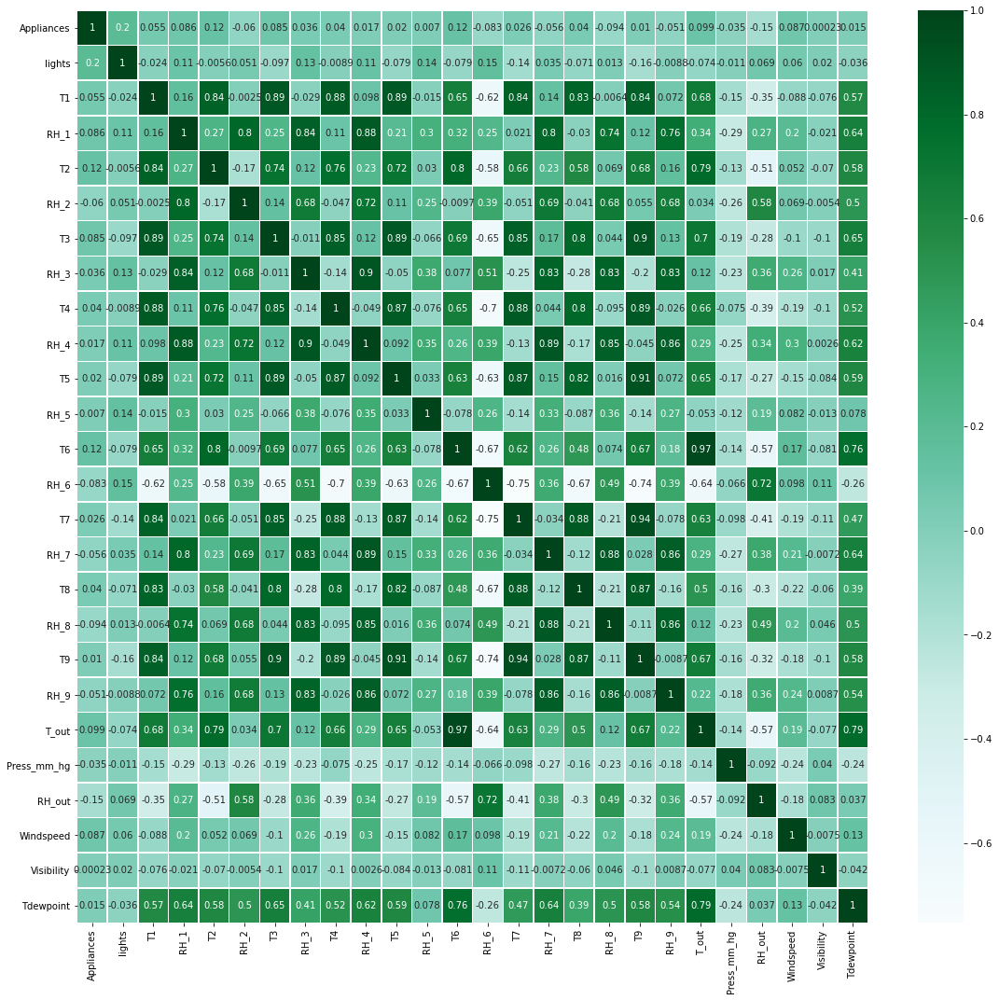

In [20]:
# Checking continuous variables relationship with each other
fig, ax = plt.subplots(figsize=(19,18))         # Sample figsize in inches
sns.heatmap(appliances_df[['Appliances','lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint']].corr(), cmap='BuGn', annot = True,linewidths=.5, ax=ax)
plt.show()

#### Once again we can see that Temperature variables are the most correlated with each other , same as the humidity variables 

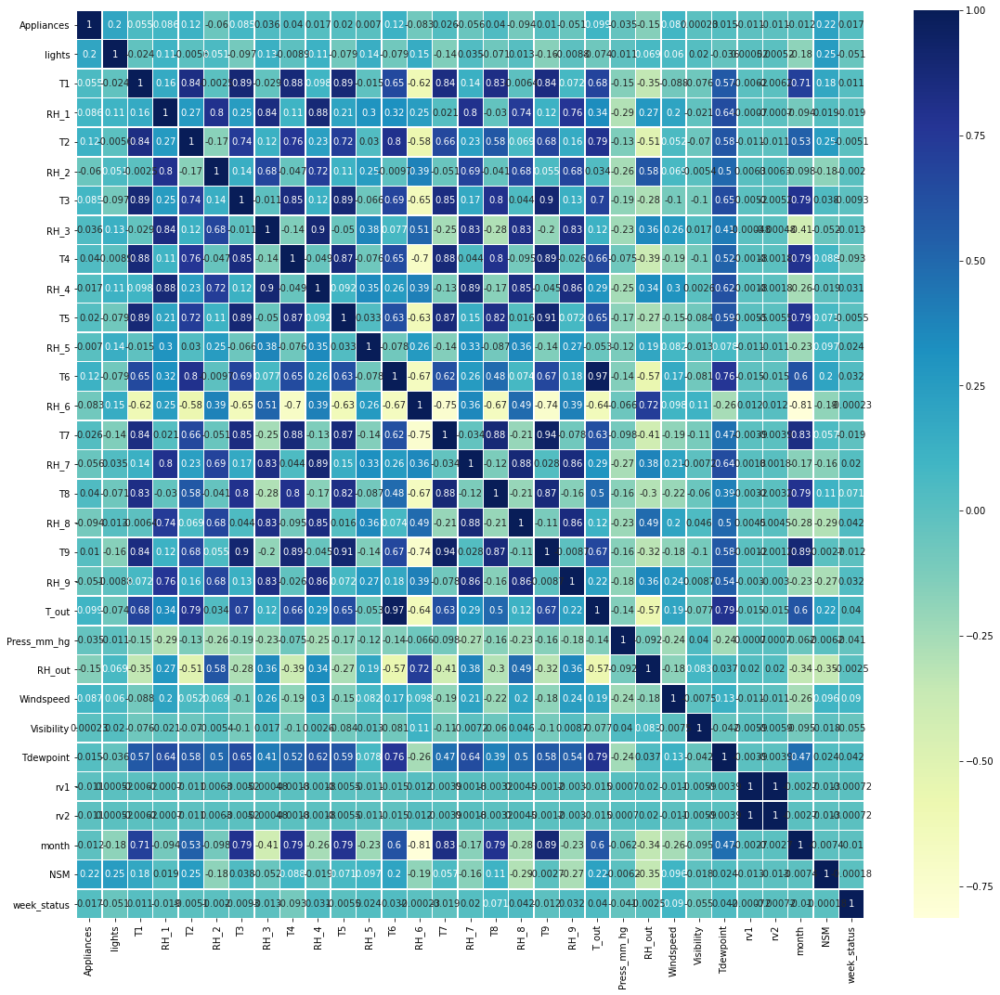

In [21]:
#Correlations for numeric variables
fig, ax = plt.subplots(figsize=(19,18))
cor=appliances_df.corr()
sns.heatmap(cor, cmap="YlGnBu", annot = True,linewidths=.5, ax=ax)
plt.show()

####  Analysing Categorical Variabels with target variables 

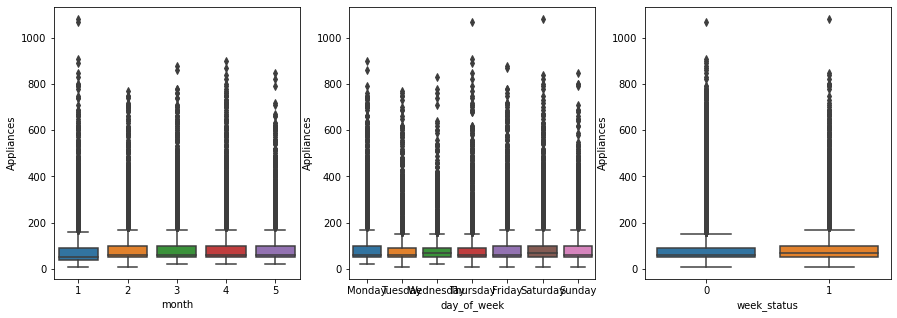

In [22]:
# Boxplot for categorical variables to see demands
vars_cat = ['month', 'day_of_week','week_status']
plt.figure(figsize=(15, 5))
for i in enumerate(vars_cat):
    plt.subplot(1,3,i[0]+1)
    sns.boxplot(data=appliances_df, x=i[1], y='Appliances')
plt.show()

#### _`Inference`_:
    the boxplots dont provide any clear picture abount the appliances 
    energy consumption.
   

## Data Preparation for Linear Regression 

####  Create dummy variables for all categorical variables

- Dropping the first columns as (p-1) dummies can explain p categories.

In [23]:
appliances_df = pd.get_dummies(data=appliances_df,columns=['month', 'day_of_week','week_status'],drop_first=False)

In [24]:
#Print columns after creating dummies
appliances_df.columns

Index(['Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4',
       'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9',
       'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility',
       'Tdewpoint', 'rv1', 'rv2', 'NSM', 'month_1', 'month_2', 'month_3',
       'month_4', 'month_5', 'day_of_week_Friday', 'day_of_week_Monday',
       'day_of_week_Saturday', 'day_of_week_Sunday', 'day_of_week_Thursday',
       'day_of_week_Tuesday', 'day_of_week_Wednesday', 'week_status_0',
       'week_status_1'],
      dtype='object')

In [25]:
#Print few rows to inspect
appliances_df.head()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,month_5,day_of_week_Friday,day_of_week_Monday,day_of_week_Saturday,day_of_week_Sunday,day_of_week_Thursday,day_of_week_Tuesday,day_of_week_Wednesday,week_status_0,week_status_1
0,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,...,0,0,1,0,0,0,0,0,1,0
1,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,...,0,0,1,0,0,0,0,0,1,0
2,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,...,0,0,1,0,0,0,0,0,1,0
3,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,...,0,0,1,0,0,0,0,0,1,0
4,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,...,0,0,1,0,0,0,0,0,1,0


##  Model Building

##  Split Data into training and test

In [26]:
# Checking shape before splitting
appliances_df.shape

(19735, 43)

In [27]:
#y to contain only target variable
y=appliances_df.pop('Appliances')

#X is all remainign variable also our independent variables
X=appliances_df

#Train Test split with 75:25 ratio
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [28]:
#Inspect independent variables
X.head()

,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,...,month_5,day_of_week_Friday,day_of_week_Monday,day_of_week_Saturday,day_of_week_Sunday,day_of_week_Thursday,day_of_week_Tuesday,day_of_week_Wednesday,week_status_0,week_status_1
0,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,...,0,0,1,0,0,0,0,0,1,0
1,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,...,0,0,1,0,0,0,0,0,1,0
2,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,...,0,0,1,0,0,0,0,0,1,0
3,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,...,0,0,1,0,0,0,0,0,1,0
4,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,...,0,0,1,0,0,0,0,0,1,0


In [29]:
# Checking shape and size for train and test
print(X_train.shape)
print(X_test.shape)

(14801, 42)
(4934, 42)


### Feature Scaling continuous variables

To make all features in same scale to interpret easily


In [30]:
# Importing required library
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.preprocessing import MinMaxScaler

In [31]:
# Let us scale continuous variables
num_vars = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4',
       'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9',
       'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility',
       'Tdewpoint', 'rv1', 'rv2', 'NSM']

#Use Normalized scaler to scale
scaler = MinMaxScaler()

#Fit and transform training set only
X_train[num_vars] = scaler.fit_transform(X_train[num_vars])

In [32]:
#Inspect stats fro Training set after scaling
X_train.describe()

,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,...,month_5,day_of_week_Friday,day_of_week_Monday,day_of_week_Saturday,day_of_week_Sunday,day_of_week_Thursday,day_of_week_Tuesday,day_of_week_Wednesday,week_status_0,week_status_1
count,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,...,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000
mean,0.054687,0.516883,0.435375,0.308225,0.580213,0.420644,0.489666,0.517766,0.468373,0.406967,...,0.195730,0.144855,0.139653,0.137423,0.141409,0.145463,0.146950,0.144247,0.721167,0.278833
std,0.114050,0.169769,0.130427,0.159543,0.119108,0.166464,0.151830,0.184296,0.191132,0.176483,...,0.396775,0.351967,0.346638,0.344305,0.348455,0.352579,0.354068,0.351352,0.448440,0.448440
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.419219,0.340132,0.195542,0.506390,0.298272,0.380122,0.396396,0.315118,0.281414,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.507920,0.414803,0.283499,0.582480,0.407112,0.457704,0.495495,0.441447,0.387960,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
75%,0.000000,0.613516,0.527522,0.392537,0.664130,0.505982,0.607260,0.630631,0.605866,0.503583,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [33]:
X_train.head()

,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,...,month_5,day_of_week_Friday,day_of_week_Monday,day_of_week_Saturday,day_of_week_Sunday,day_of_week_Thursday,day_of_week_Tuesday,day_of_week_Wednesday,week_status_0,week_status_1
8242,0.0,0.444562,0.366447,0.174461,0.577407,0.251745,0.431531,0.434835,0.269234,0.324892,...,0,0,0,0,0,0,1,0,1,0
10603,0.0,0.444562,0.441667,0.166465,0.687543,0.398804,0.445085,0.428529,0.460566,0.381589,...,0,1,0,0,0,0,0,0,1,0
18910,0.0,0.834213,0.738575,0.598236,0.777359,0.800432,0.704471,0.801558,0.815199,0.725946,...,1,0,0,0,1,0,0,0,0,1
16772,0.0,0.739176,0.352193,0.402229,0.540533,0.606514,0.437451,0.765766,0.363503,0.551362,...,1,0,0,1,0,0,0,0,0,1
16805,0.0,0.739176,0.404715,0.877974,0.315462,0.656364,0.398349,0.765766,0.400416,0.703615,...,1,0,0,1,0,0,0,0,0,1


##  Build a Model using RFE and Automated approach

#### Use RFE to eliminate some columns

In [34]:
# Build a Lienar Regression model using SKLearn for RFE
lr = LinearRegression()
lr.fit(X_train,y_train)

LinearRegression()

In [35]:
#Cut down number of features to 15 using automated approach
rfe = RFE(lr,30)
rfe.fit(X_train,y_train)

RFE(estimator=LinearRegression(), n_features_to_select=30)

In [36]:
#Columns selected by RFE and their weights
list(zip(X_train.columns,rfe.support_,rfe.ranking_))

[('lights', True, 1),
 ('T1', True, 1),
 ('RH_1', True, 1),
 ('T2', True, 1),
 ('RH_2', True, 1),
 ('T3', True, 1),
 ('RH_3', True, 1),
 ('T4', True, 1),
 ('RH_4', True, 1),
 ('T5', True, 1),
 ('RH_5', False, 7),
 ('T6', True, 1),
 ('RH_6', True, 1),
 ('T7', False, 6),
 ('RH_7', True, 1),
 ('T8', True, 1),
 ('RH_8', True, 1),
 ('T9', True, 1),
 ('RH_9', False, 3),
 ('T_out', True, 1),
 ('Press_mm_hg', False, 5),
 ('RH_out', True, 1),
 ('Windspeed', True, 1),
 ('Visibility', True, 1),
 ('Tdewpoint', True, 1),
 ('rv1', False, 12),
 ('rv2', False, 13),
 ('NSM', True, 1),
 ('month_1', True, 1),
 ('month_2', True, 1),
 ('month_3', True, 1),
 ('month_4', True, 1),
 ('month_5', True, 1),
 ('day_of_week_Friday', True, 1),
 ('day_of_week_Monday', False, 11),
 ('day_of_week_Saturday', True, 1),
 ('day_of_week_Sunday', False, 8),
 ('day_of_week_Thursday', False, 2),
 ('day_of_week_Tuesday', True, 1),
 ('day_of_week_Wednesday', False, 4),
 ('week_status_0', False, 9),
 ('week_status_1', False, 10)

##  Manual elimination

##### Function to build a model using statsmodel api

In [37]:
#Function to build a model using statsmodel api - Takes the columns to be selected for model as a parameter
def build_model(cols):
    X_train_sm = sm.add_constant(X_train[cols])
    lm = sm.OLS(y_train, X_train_sm).fit()
    print(lm.summary())
    return lm

##### Function to calculate VIFs and print them

In [38]:
#Function to calculate VIFs and print them -Takes the columns for which VIF to be calcualted as a parameter
def get_vif(cols):
    df1 = X_train[cols]
    vif = pd.DataFrame()
    vif['Features'] = df1.columns
    vif['VIF'] = [variance_inflation_factor(df1.values, i) for i in range(df1.shape[1])]
    vif['VIF'] = round(vif['VIF'],2)
    print(vif.sort_values(by='VIF',ascending=False))

In [39]:
#Print Columns selected by RFE. We will start with these columns for manual elimination
X_train.columns[rfe.support_]

Index(['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4', 'T5',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out', 'RH_out',
       'Windspeed', 'Visibility', 'Tdewpoint', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'month_5', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday'],
      dtype='object')

In [40]:
# Features not selected by RFE
X_train.columns[~rfe.support_]

Index(['RH_5', 'T7', 'RH_9', 'Press_mm_hg', 'rv1', 'rv2', 'day_of_week_Monday',
       'day_of_week_Sunday', 'day_of_week_Thursday', 'day_of_week_Wednesday',
       'week_status_0', 'week_status_1'],
      dtype='object')

In [41]:
# Taking 30 columns supported by RFE for regression
X_train_rfe = X_train[['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4', 'T5',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out', 'RH_out',
       'Windspeed', 'Visibility', 'Tdewpoint', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'month_5', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']]

In [42]:
X_train_rfe.shape

(14801, 30)

In [43]:
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4', 'T5',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out', 'RH_out',
       'Windspeed', 'Visibility', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'month_5', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']
X_train[cols].shape


(14801, 29)

#  Build Model 

###  Model 1 - Start with all variables selected by RFE

In [44]:
#Selected columns for Model 1 - all columns selected by RFE
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4', 'T5',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out', 'RH_out',
       'Windspeed', 'Visibility', 'Tdewpoint', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'month_5', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']


build_model(cols)
get_vif(cols)

                            OLS Regression Results                            
Dep. Variable:             Appliances   R-squared:                       0.183
Model:                            OLS   Adj. R-squared:                  0.181
Method:                 Least Squares   F-statistic:                     114.0
Date:                Wed, 13 Apr 2022   Prob (F-statistic):               0.00
Time:                        00:26:02   Log-Likelihood:                -88171.
No. Observations:               14801   AIC:                         1.764e+05
Df Residuals:                   14771   BIC:                         1.766e+05
Df Model:                          29                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                  108.0390 

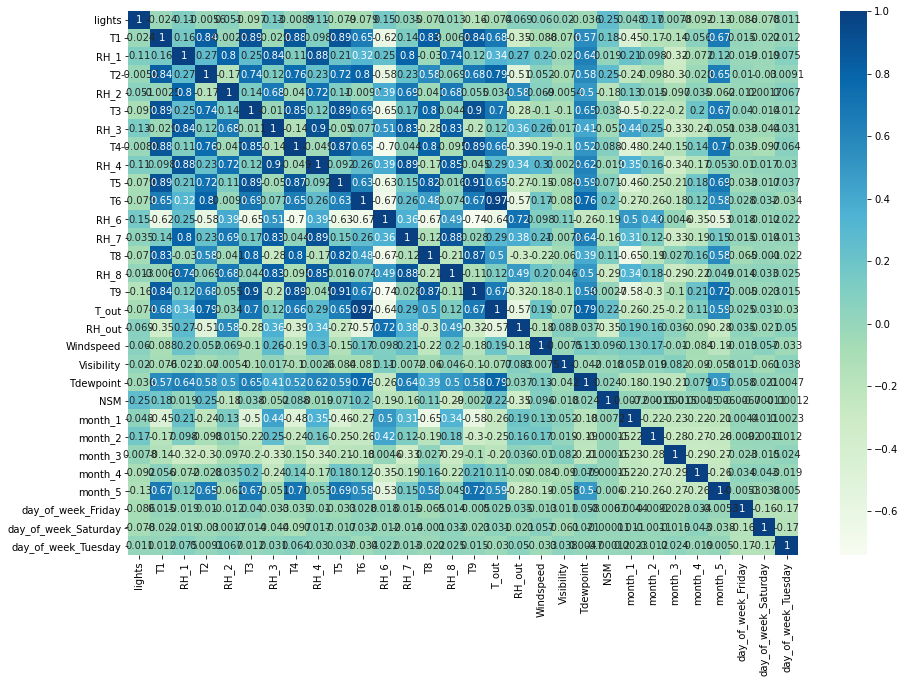

In [45]:
# Checking correlation of features selected by RFE with target column. 
# Also to check impact of different features on target.
plt.figure(figsize = (15,10))
sns.heatmap(appliances_df[['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4', 'T5',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out', 'RH_out',
       'Windspeed', 'Visibility', 'Tdewpoint', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'month_5', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']].corr(), cmap='GnBu', annot=True)
plt.show()

## Model 2

In [46]:
# Dropping the variable T4 as it is the most insignificant having the highest p-value
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'RH_4', 'T5',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out', 'RH_out',
       'Windspeed', 'Visibility', 'Tdewpoint', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'month_5', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']
build_model(cols)
get_vif(cols)

                            OLS Regression Results                            
Dep. Variable:             Appliances   R-squared:                       0.183
Model:                            OLS   Adj. R-squared:                  0.181
Method:                 Least Squares   F-statistic:                     118.0
Date:                Wed, 13 Apr 2022   Prob (F-statistic):               0.00
Time:                        00:26:07   Log-Likelihood:                -88171.
No. Observations:               14801   AIC:                         1.764e+05
Df Residuals:                   14772   BIC:                         1.766e+05
Df Model:                          28                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                  108.7443 

## Model 3

In [47]:
# Dropping the variable month_5 as it is the most insignificant having the highest p-value
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'RH_4', 'T5',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out', 'RH_out',
       'Windspeed', 'Visibility', 'Tdewpoint', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']
build_model(cols)
get_vif(cols)

                            OLS Regression Results                            
Dep. Variable:             Appliances   R-squared:                       0.183
Model:                            OLS   Adj. R-squared:                  0.181
Method:                 Least Squares   F-statistic:                     118.0
Date:                Wed, 13 Apr 2022   Prob (F-statistic):               0.00
Time:                        00:26:08   Log-Likelihood:                -88171.
No. Observations:               14801   AIC:                         1.764e+05
Df Residuals:                   14772   BIC:                         1.766e+05
Df Model:                          28                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                  111.0493 

## Model 4

In [48]:
# Dropping the variable T5 as it is the most insignificant having the highest p-value
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'RH_4',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out', 'RH_out',
       'Windspeed', 'Visibility', 'Tdewpoint', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']
build_model(cols)
get_vif(cols)

                            OLS Regression Results                            
Dep. Variable:             Appliances   R-squared:                       0.183
Model:                            OLS   Adj. R-squared:                  0.181
Method:                 Least Squares   F-statistic:                     122.4
Date:                Wed, 13 Apr 2022   Prob (F-statistic):               0.00
Time:                        00:26:09   Log-Likelihood:                -88171.
No. Observations:               14801   AIC:                         1.764e+05
Df Residuals:                   14773   BIC:                         1.766e+05
Df Model:                          27                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                  112.3757 

## Model 5

In [49]:
# Dropping the variable RH_out as it is the most insignificant having the highest p-value
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'RH_4',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out',
       'Windspeed', 'Visibility', 'Tdewpoint', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']
build_model(cols)
get_vif(cols)

                            OLS Regression Results                            
Dep. Variable:             Appliances   R-squared:                       0.183
Model:                            OLS   Adj. R-squared:                  0.181
Method:                 Least Squares   F-statistic:                     127.0
Date:                Wed, 13 Apr 2022   Prob (F-statistic):               0.00
Time:                        00:26:10   Log-Likelihood:                -88172.
No. Observations:               14801   AIC:                         1.764e+05
Df Residuals:                   14774   BIC:                         1.766e+05
Df Model:                          26                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   79.2418 

## Model 6

In [50]:
# Dropping the variable Tdewpoint as it is the most insignificant having the highest p-value
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'RH_4',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out',
       'Windspeed', 'Visibility', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']
build_model(cols)
get_vif(cols)

                            OLS Regression Results                            
Dep. Variable:             Appliances   R-squared:                       0.183
Model:                            OLS   Adj. R-squared:                  0.181
Method:                 Least Squares   F-statistic:                     132.1
Date:                Wed, 13 Apr 2022   Prob (F-statistic):               0.00
Time:                        00:26:11   Log-Likelihood:                -88173.
No. Observations:               14801   AIC:                         1.764e+05
Df Residuals:                   14775   BIC:                         1.766e+05
Df Model:                          25                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   77.2366 

## Model 7

In [51]:
# Dropping the variable RH4 as it is the most insignificant having the highest p-value
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out',
       'Windspeed', 'Visibility', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']
build_model(cols)
get_vif(cols)

                            OLS Regression Results                            
Dep. Variable:             Appliances   R-squared:                       0.183
Model:                            OLS   Adj. R-squared:                  0.181
Method:                 Least Squares   F-statistic:                     137.5
Date:                Wed, 13 Apr 2022   Prob (F-statistic):               0.00
Time:                        00:26:12   Log-Likelihood:                -88174.
No. Observations:               14801   AIC:                         1.764e+05
Df Residuals:                   14776   BIC:                         1.766e+05
Df Model:                          24                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   84.7218 

#### All the columns have p-value > .05 so checking VIFs

## Model 8

In [52]:
# Dropping the variable month_2 as it is the most insignificant having the highest p-value
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out',
       'Windspeed', 'Visibility', 'NSM', 'month_1',
       'month_3', 'month_4', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']
build_model(cols)
get_vif(cols)

                            OLS Regression Results                            
Dep. Variable:             Appliances   R-squared:                       0.182
Model:                            OLS   Adj. R-squared:                  0.181
Method:                 Least Squares   F-statistic:                     143.2
Date:                Wed, 13 Apr 2022   Prob (F-statistic):               0.00
Time:                        00:26:13   Log-Likelihood:                -88176.
No. Observations:               14801   AIC:                         1.764e+05
Df Residuals:                   14777   BIC:                         1.766e+05
Df Model:                          23                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   95.3434 

## Model 9

#### dropping variable month_2 decreased model's accuracy 

In [53]:
# 
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out',
       'Windspeed', 'Visibility', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']
build_model(cols)
get_vif(cols)

                            OLS Regression Results                            
Dep. Variable:             Appliances   R-squared:                       0.183
Model:                            OLS   Adj. R-squared:                  0.181
Method:                 Least Squares   F-statistic:                     137.5
Date:                Wed, 13 Apr 2022   Prob (F-statistic):               0.00
Time:                        00:26:14   Log-Likelihood:                -88174.
No. Observations:               14801   AIC:                         1.764e+05
Df Residuals:                   14776   BIC:                         1.766e+05
Df Model:                          24                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   84.7218 

#### `_Inference`_
Let us select Model 9 as our final as it has the highest R-square, Adjusted R-squared and F-statistic, even though there is much  multi coliinearity (high VIF variables). However p-value for all the features is  almost 0.0 and R2 is 0.183 , for any other change in the model those values decrease , indicating that this is indeed the best model for linear regression.
Difference between R-squared and Adjusted R-squared values for this model is veryless, which also means that there are no additional parameters that can be removed from this model.

In [54]:
#Build a model with all columns to select features automatically
def build_model_sk(X,y):
    lr1 = LinearRegression()
    lr1.fit(X,y)
    return lr1


In [55]:
#Let us build the finalmodel using sklearn
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out',
       'Windspeed', 'Visibility', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']

#Build a model with above columns
lr = build_model_sk(X_train[cols],y_train)
print(lr.intercept_,lr.coef_)

84.72184357489122 [ 139.12138629  -62.30781652  511.03255911 -257.5870186  -539.28374883
  338.20584784  100.45301341  217.40922622   24.03057609  -38.71625638
  103.37119283 -126.57098767  -81.99167386 -186.48444366   26.17507239
   11.94766867   23.35338196   42.34306766   12.77854472   31.68305979
   12.22491126   17.98123712   19.60022707   -7.88090588]


## Model Evaluation 
###  Residucal Analysis

In [56]:
y_train_pred = lr.predict(X_train[cols])

In [57]:
#Plot a histogram of the error terms
def plot_res_dist(act, pred):
    sns.distplot(act-pred)
    plt.title('Error Terms')
    plt.xlabel('Errors')

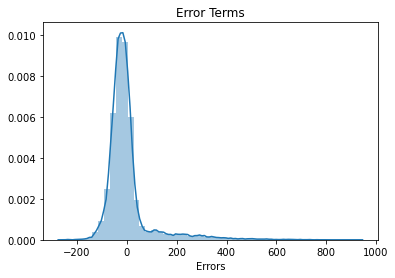

In [58]:
plot_res_dist(y_train, y_train_pred)

#### Errors are approximately normally distribured here with mean 0. So everything seems to be fine

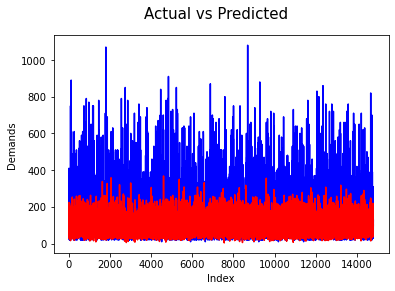

In [59]:
# Actual vs Predicted
c = [i for i in range(0,len(X_train),1)]
plt.plot(c,y_train, color="blue")
plt.plot(c,y_train_pred, color="red")
plt.suptitle('Actual vs Predicted', fontsize = 15)
plt.xlabel('Index')
plt.ylabel('Demands')
plt.show()

#### Actual and Predicted result differ as expected 

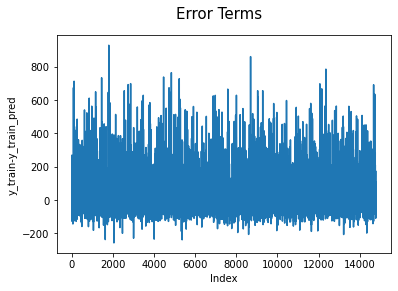

In [60]:
# Error Terms
c = [i for i in range(0,len(X_train),1)]
plt.plot(c,y_train-y_train_pred)
plt.suptitle('Error Terms', fontsize = 15)
plt.xlabel('Index')
plt.ylabel('y_train-y_train_pred')
plt.show()

#### Here,If we see the error terms are independent of each other.

In [61]:
#Print R-squared Value
r2_score(y_train,y_train_pred)

0.1825633431901179

### _`Inference`_
R2 Same as we obtained for our final model

### 7.2 Linearity Check

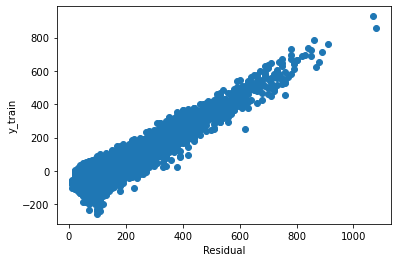

In [62]:
# scatter plot for the check
residual = (y_train - y_train_pred)
plt.scatter(y_train,residual)
plt.ylabel("y_train")
plt.xlabel("Residual")
plt.show()

### Predict values for test data set

In [63]:
#Scale variables in X_test
num_vars = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4',
       'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9',
       'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility',
       'Tdewpoint', 'rv1', 'rv2', 'NSM']

#Test data to be transformed only, no fitting
X_test[num_vars] = scaler.transform(X_test[num_vars])

In [64]:
#Columns from our final model
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out',
       'Windspeed', 'Visibility', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']

#Predict the values for test data
y_test_pred = lr.predict(X_test[cols])

###  R-Squared value for test predictions

In [65]:
# Find out the R squared value between test and predicted test data sets.  
r2_score(y_test,y_test_pred)

0.1632741492282822

### Homoscedacity

##### _`Inference`_ 
R2 value for predictions on test data (0.183) differs from the R2 value of train data(0.163). This is not a good R-squared value, hence we can see that our model is not performing as good on unseen data (test data)

Text(0, 0.5, 'y_test_pred')

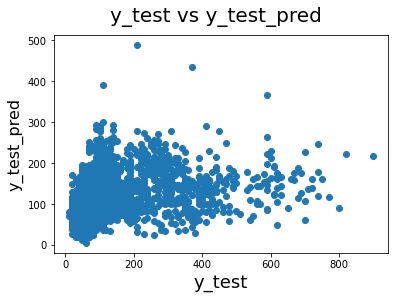

In [66]:
# Plotting y_test and y_test_pred to understand the spread

fig = plt.figure()
plt.scatter(y_test, y_test_pred)
fig.suptitle('y_test vs y_test_pred', fontsize = 20)              # Plot heading 
plt.xlabel('y_test', fontsize = 18)                          # X-label
plt.ylabel('y_test_pred', fontsize = 16)

####  _`Inference`_
We can observe that variance of the residuals (error terms) is not constant across predictions.  i.e error term varys as the value of the predictor variable changes.

### Plot Test vs Predicted test values

In [67]:
#Function to plot Actual vs Predicted
#Takes Actual and PRedicted values as input along with the scale and Title to indicate which data
def plot_act_pred(act,pred,scale,dataname):
    c = [i for i in range(1,scale,1)]
    fig = plt.figure(figsize=(14,5))
    plt.plot(c,act, color="blue", linewidth=2.5, linestyle="-")
    plt.plot(c,pred, color="red",  linewidth=2.5, linestyle="-")
    fig.suptitle('Actual and Predicted - '+dataname, fontsize=20)              # Plot heading 
    plt.xlabel('Index', fontsize=18)                               # X-label
    plt.ylabel('Counts', fontsize=16)                               # Y-label

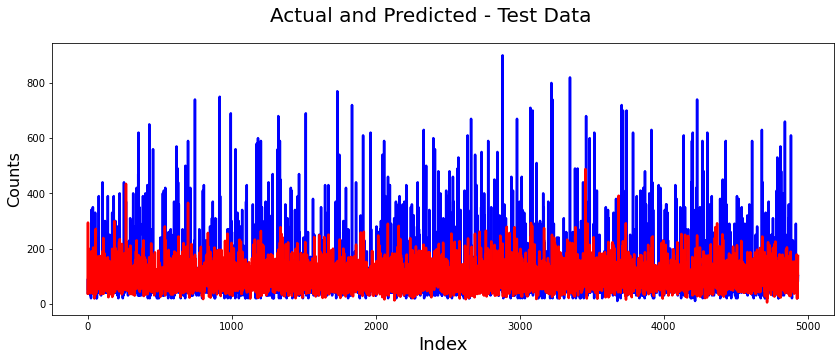

In [68]:
#Plot Actual vs Predicted for Test Data
plot_act_pred(y_test,y_test_pred,len(y_test)+1,'Test Data')

#### _`Inference`_
As we can see predictions for the test data are not very close to the actuals. Given the model's accuracy results could have been worse.

### Plot Error Terms for test data

In [69]:
# Error terms
def plot_err_terms(act,pred):
    c = [i for i in range(1,4935,1)]
    fig = plt.figure(figsize=(14,5))
    plt.plot(c,act-pred, color="blue", marker='o', linewidth=2.5, linestyle="")
    fig.suptitle('Error Terms', fontsize=20)              # Plot heading 
    plt.xlabel('Index', fontsize=18)                      # X-label
    plt.ylabel('Counts - Predicted Counts', fontsize=16)                # Y-label

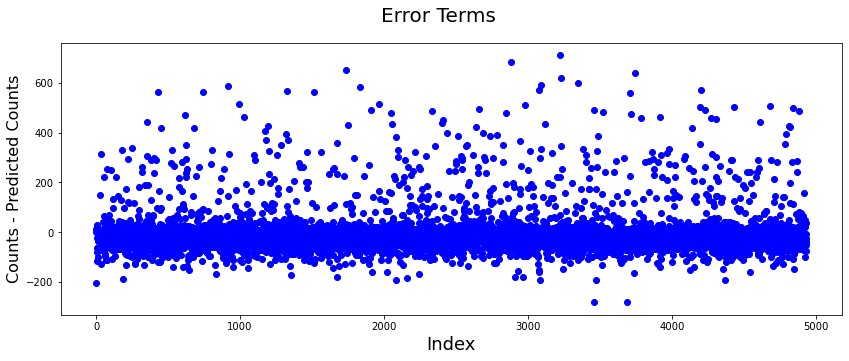

In [70]:
#Plot error terms for test data
plot_err_terms(y_test,y_test_pred)

#### _`Inference`_
As we can see the error terms are mostly distributed accross the horizontal axis which means the output is not explained very well by the model.

###  Making Predictions

In [71]:
# Checking data before scaling
appliances_df.head()

,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,...,month_5,day_of_week_Friday,day_of_week_Monday,day_of_week_Saturday,day_of_week_Sunday,day_of_week_Thursday,day_of_week_Tuesday,day_of_week_Wednesday,week_status_0,week_status_1
0,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,...,0,0,1,0,0,0,0,0,1,0
1,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,...,0,0,1,0,0,0,0,0,1,0
2,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,...,0,0,1,0,0,0,0,0,1,0
3,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,...,0,0,1,0,0,0,0,0,1,0
4,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,...,0,0,1,0,0,0,0,0,1,0


###  Intrepretting the Model

#### Let us go with interpretting the RFE with Manual model results as we give more importance to imputation

In [72]:
#Let us rebuild the final model of manual + rfe approach using statsmodel to interpret it
cols = ['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3',
       'T6', 'RH_6', 'RH_7', 'T8', 'RH_8', 'T9', 'T_out',
       'Windspeed', 'Visibility', 'NSM', 'month_1', 'month_2',
       'month_3', 'month_4', 'day_of_week_Friday',
       'day_of_week_Saturday', 'day_of_week_Tuesday']

lm = build_model(cols)


                            OLS Regression Results                            
Dep. Variable:             Appliances   R-squared:                       0.183
Model:                            OLS   Adj. R-squared:                  0.181
Method:                 Least Squares   F-statistic:                     137.5
Date:                Wed, 13 Apr 2022   Prob (F-statistic):               0.00
Time:                        00:26:17   Log-Likelihood:                -88174.
No. Observations:               14801   AIC:                         1.764e+05
Df Residuals:                   14776   BIC:                         1.766e+05
Df Model:                          24                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   84.7218 

### Interepretation of results

### Analysing the above model
- Temperature contributes negatively in the use of appliances.
- Energy use seems to have increased during the first month.
- Energy use seems to decrease during Tuesdays.
- RH_1 has the greatest coefficient in this model.

### _`Conclusion`_
Significant variables to predict the appliances energy use
- lights
- T1
- RH_1
- T2 
- RH_2
- T3
- RH_3
- T6
- RH_6 
- RH_7
- T8
- RH_8 
- T9
- T_out
- Windspeed
- Visibility
- NSM
- month_1
- month_2
- month_3
- month_4
- day_of_week_Friday
- day_of_week_Saturday
- day_of_week_Tuesday